In [1]:
from cv_methods import load_image, save_image, image_to_array, array_to_image, process_image_naive
from measurements import Measurements

CFA_path = "CFA.bmp"
RGB_CFA_path = "RGB_CFA.bmp"
Original_path = "Original.bmp"

In [2]:
CFA = load_image(CFA_path)
CFA_array = image_to_array(CFA)

Original = load_image(Original_path)
Original_array = image_to_array(Original)

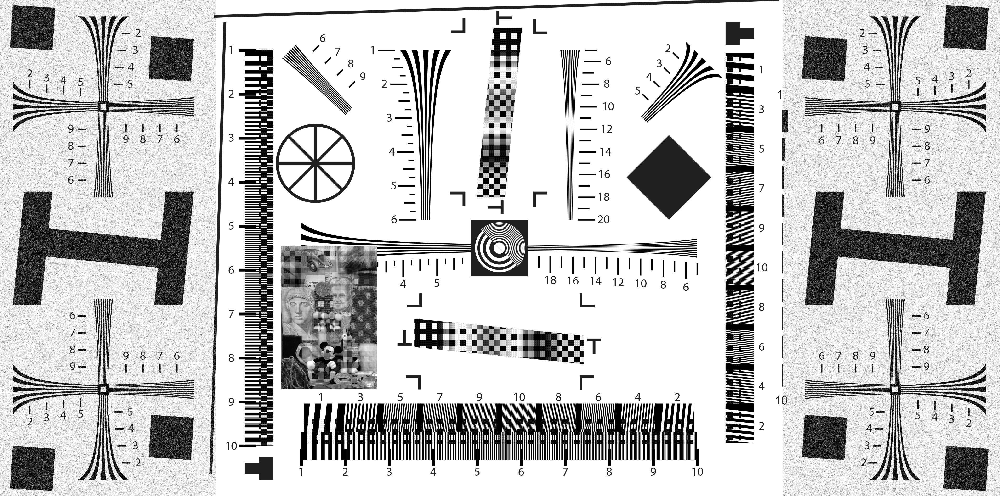

In [3]:
CFA

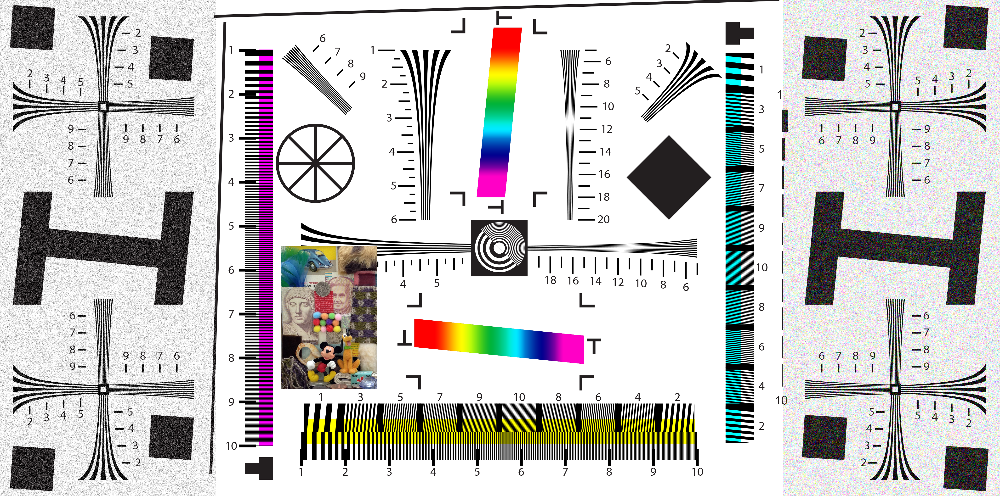

In [4]:
Original

### Шаг 0. Инструменты для измерения
Реализуем класс для измерения времени работы алгоритма, производительности и PSNR получающегося изображения.
Это класс Measurements в файле measurements.py проекта

- Метод measure должен выполнять все эти измерения.
- При инициализации нужно будет указать в качестве параметров среди прочих window -- окно исходного изображения, которое будем преобразовывать. Это потребуется нам, чтобы проверять алгоритм на части изображения для скорости проверки

### Шаг 1. Наивная реализация
Реализуем наивный (не оптимальный) алгоритм vng_naive в файле cv_methods и переопределим им основной


In [5]:
class Naive(Measurements):
    def process(self):
        self.res_image = process_image_naive(self.cfa_array, self.window)


Проверим на небольшом кусочке изображения, содержащим цвета (самое интересное)

In [6]:
naive = Naive(CFA_array, Original_array, window=[1400, 1420, 1500, 2500])
naive_image, _, _, _, _ = naive.measure()

MegaPixels: 0.02, Total time: 7.96 seconds, Seconds to MegaPixel: 398.04, PSNR: 15.131252090286955


In [7]:
array_to_image(naive_image)

Кажется, метод работает. Давайте запустим его на полном изображении (долго) и посмотрим на получившееся изображение, а также сохраним его.

MegaPixels: 8.656848, Total time: 731.66 seconds, Seconds to MegaPixel: 84.52, PSNR: 24.24837808749399


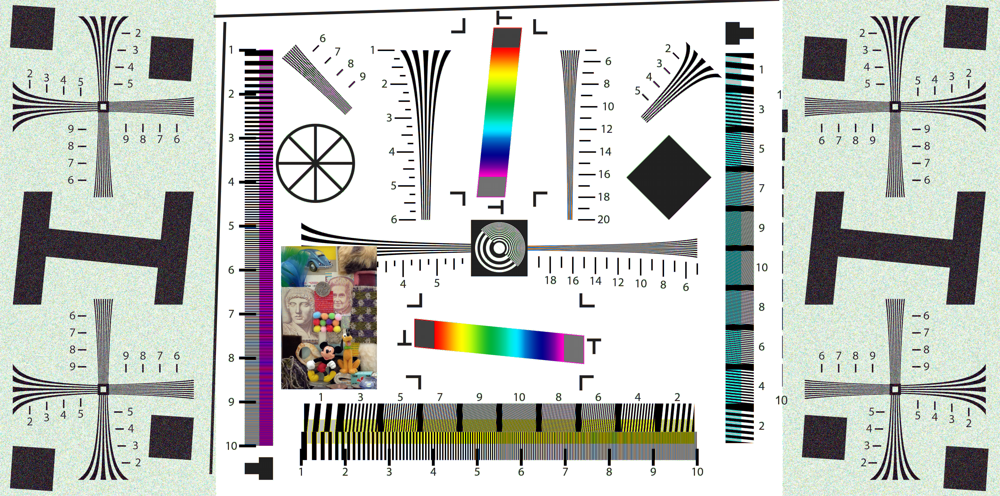

In [8]:
naive = Naive(CFA_array, Original_array, window=None)
naive_image_array, _, _, _, naive_psnr = naive.measure()

naive_image = array_to_image(naive_image_array)
save_image(naive_image, "Processed_naive.bmp")

naive_image

Видно, что изображение преобразовалось правильно. Проанализируем, во сколько раз снижается разрешение.

**Оригинал (слева), Восстановленное (справа)**

<img src="orig_1.png" alt="orig_1" width="400"/>
<img src="process_1.png" alt="process_1" width="400"/>


**Оригинал (слева), Восстановленное (справа)**

<img src="orig_2.png" alt="orig_2" height="400"/>
<img src="process_2.png" alt="process_2" height="400"/>

**На самой мелкой сетке становятся отчетливо видны артефакты преобразования, однако на преобразованном изображении линии всё ещё различимы.**

#### Итоговые результаты:

MegaPixels: 8.656848, 

Total time: 731.66 seconds, 

Seconds to MegaPixel: 84.52, 

PSNR: 24.24837808749399